# FP 2

In [1]:
import sys
import os
sys.path.insert(0, "../../python")

import numpy as np
from beam.beams import laserpulse
from beam.beams import laserbeam
from beam.elements import plasma
from beam.elements import optic
from beam import interactions
from ionization import ionization
from ionization import adk
from lens import profile
from lens import bessel
from lens import ray
from lens import design
import matplotlib.pyplot as plt
from ionization import adk
from scipy.interpolate import interp1d
from scipy.optimize import newton
plt.style.use('presentation')
%load_ext autoreload
%autoreload 2

path = '/mnt/md0/Data/rariniello/Filamentation/FP_2/'
lam = 0.8
tau = 40.

Filamentation plasma source that matches the OSIRIS simulations run by Chaojie at UCLA.

In [2]:
def plot_laser_plasma(I, ne, ext, name=None):
    plt.figure(figsize=(16, 4), dpi=300)
    plt.subplot(121)
    plt.imshow(np.flipud(np.transpose(I)), aspect='auto', extent=ext, cmap='viridis')
    cb = plt.colorbar()
    cb.set_label(r'Laser Intensity ($10^{14} W/cm^2$)')
    plt.xlabel('z (mm)')
    plt.ylabel(r'x ($\mathrm{\mu m}$)')
    plt.ylim(-200, 200)

    plt.subplot(122)
    plt.imshow(np.flipud(np.transpose(ne)), aspect='auto', extent=ext, cmap='plasma')
    cb = plt.colorbar()
    cb.set_label(r'$n_e$ ($\mathrm{cm^-3}$)')
    plt.xlabel('$z$ (mm)')
    plt.ylabel(r'$x$ ($\mathrm{\mu m}$)')
    plt.ylim(-200, 200)
    plt.tight_layout()
    if name is not None:
        plt.savefig(path+name+'.png')
    plt.show()

In [3]:
def ionize_jet(energy, w0, z0, n0, atom, temp, Nx, X, Nz, Z, plot=True, suffix=None, n2=0.0):
    name = "Energy=%0.2fmJ_w0=%0.1fum_z0=%0.2fmm_n0=%0.2E_T=%0.0feV" % (energy*1e3, w0, z0*1e-3, n0, temp)
    if suffix is None:
        suffix = ''
    name += suffix
    z = np.linspace(0, Z, Nz)
    pulseParams = {
        'Nt' : 2**6,
        'Nx' : Nx,
        'Ny' : Nx,
        'X' : X,
        'Y' : X,
        'T' : 3*tau,
        'lam' : lam,
        'path' : path,
        'load' : False,
        'threads' : 20,
        'cyl' : True,
        'tau' : tau,
        'z0' : z0,
        'name' : name+'_Beam',
        'E0' : 2*np.sqrt(377*energy/np.pi/tau*1e15)/w0*1e6/1e9,
        'waist' : w0
    }

    ext = [z[0]/1e3, z[-1]/1e3, -X/2, X/2]
    beam = laserbeam.GaussianLaser(pulseParams)
    if plot:
        beam.plot_current_intensity()
    beam.propagate(z-z[0], 1.0)
    e = np.zeros((Nz, Nx), dtype='complex128')
    for i in range(Nz):
        e[i, :] = beam.load_field(i+1)[0]
        
    xaxis = np.reshape(beam.x, (Nx, 1, 1))
    yaxis = np.reshape(beam.y, (1, Nx, 1))
    zaxis = np.reshape(z, (1, 1, Nz))

    n = n0*np.ones((Nx, Nx, Nz))
    sel = zaxis > 500
    ramp = (zaxis-500)/500+1
    ramp[sel] = 1.0
    n = n*ramp
    n_slice = np.zeros((Nz, Nx))
    n_slice = np.transpose(n[:, int(Nx/2), :])

    ne = n_slice*adk.gaussian_frac(atom['EI'], abs(e), tau, atom['Z'], atom['l'])
    I = beam.intensity_from_field(e)
    if plot:
        plot_laser_plasma(I, ne, ext, name+'_beam')
    
    pulseParams['name'] = name + '_Pulse'
    plasmaParams = {
        'Nx' : Nx,
        'Ny' : Nx,
        'Nz' : Nz,
        'X' : X,
        'Y' : X,
        'Z' : Z,
        'atom' : atom,
        'path' : path,
        'load' : False,
        'cyl' : True,
        'name' : name+'_Plasma',
        'n0' : n0/1e17
    }
    pulse = laserpulse.GaussianPulse(pulseParams)
    print('Initial pulse energy %0.2fmJ' % (pulse.pulse_energy()*1e3))
    ext = [z[0]/1e3, z[-1]/1e3, -X/2, X/2]
    hydrogen = plasma.Plasma(plasmaParams)

    # Initialize gas density
    ne = np.zeros((Nx, Nx, Nz), dtype='double')
    hydrogen.initialize_plasma(n/1e17, ne)

    interactions.pulse_plasma_energy(pulse, hydrogen, temp, n2)
    print('Final pulse energy %0.2fmJ' % (pulse.pulse_energy()*1e3))
    e = np.zeros((Nz, Nx), dtype='complex128')
    ne = np.zeros((Nz, Nx))
    for i in range(0, Nz-1):
        ne[i, :] = hydrogen.load_plasma_density(i)[0]
    for i in range(Nz):
        e[i, :] = pulse.load_field(i)[0][int(pulseParams['Nt']/2), :]
    I = ionization.intensity_from_field(e)
    ne = ne*1e17
    plot_laser_plasma(I, ne, ext, name+'_pulse')
    return pulse

In [4]:
# Calculate normalized vector potential
from scipy.constants import physical_constants as consts
me = consts['electron mass']
c = consts['speed of light in vacuum']
e = consts['elementary charge']
a0 = 0.855*0.8*np.sqrt(800e-4)
print(a0)

0.193464415333


In [5]:
np.pi*35e-6**2*1e6*10e-3*1e20*20*1.602e-19

0.012330437006074576

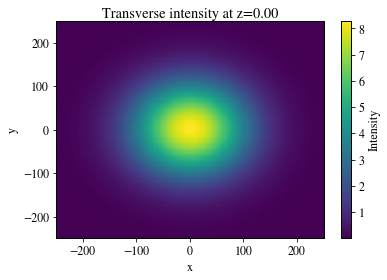

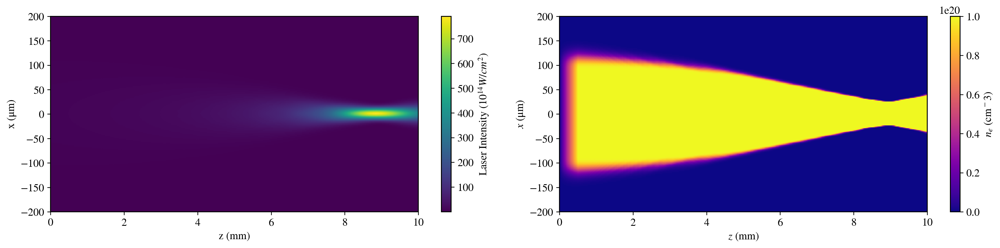

Initial pulse energy 11.98mJ
Final pulse energy 2.92mJ


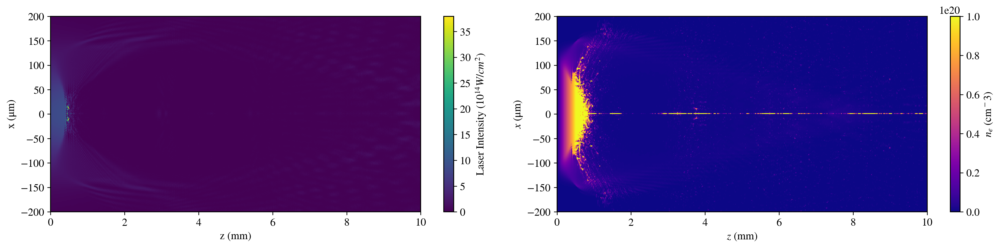

In [6]:
energy = 12e-3
w0 = 15
Nx = 2**8
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
pulse = ionize_jet(energy, w0, z0, n0, atom, temp, Nx, X, Nz, Z)

Initial pulse energy 11.98mJ
Final pulse energy 3.22mJ


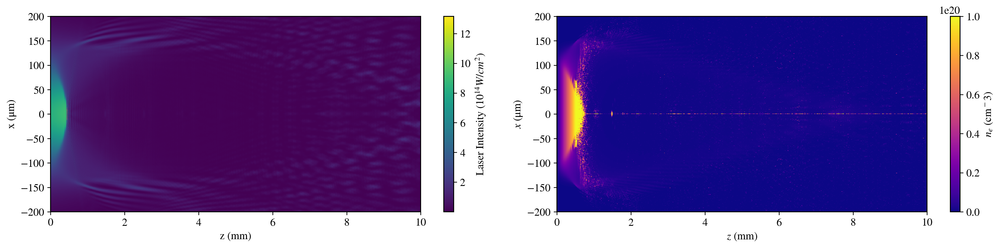

Initial pulse energy 24.96mJ
Final pulse energy 4.53mJ


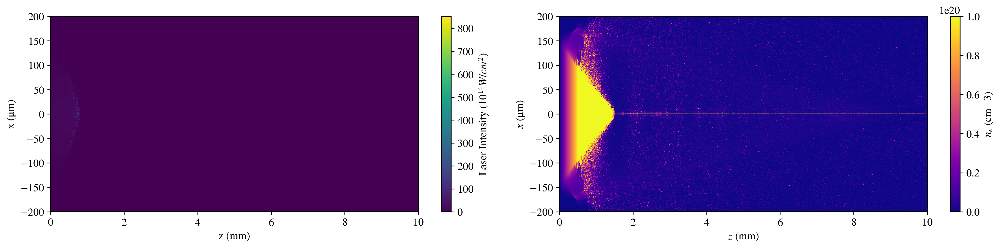

Initial pulse energy 49.93mJ
Final pulse energy 5.76mJ


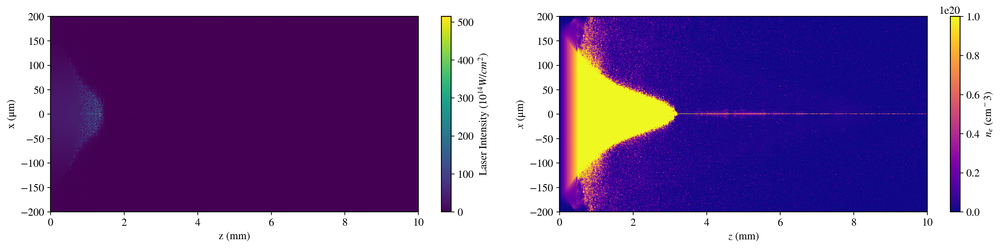

Initial pulse energy 74.89mJ
Final pulse energy 6.38mJ


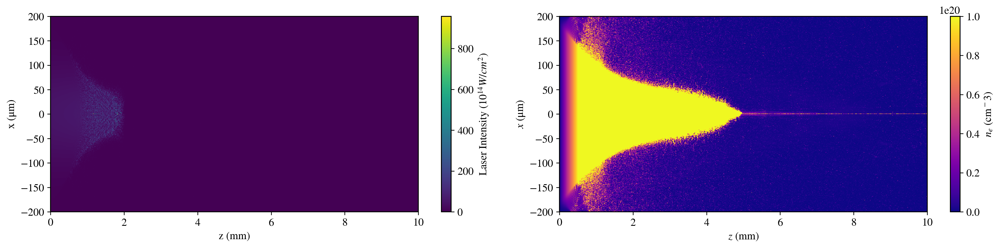

Initial pulse energy 99.86mJ
Final pulse energy 6.82mJ


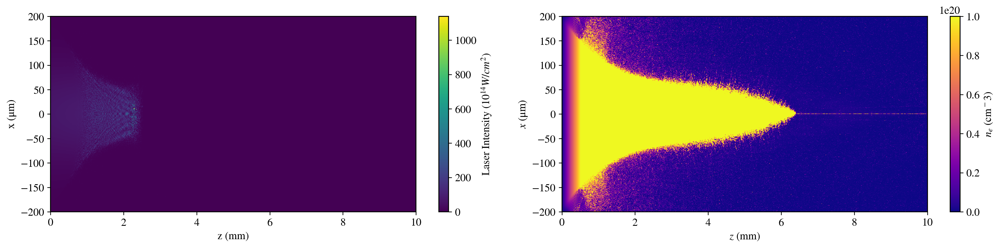

Initial pulse energy 124.82mJ
Final pulse energy 7.20mJ


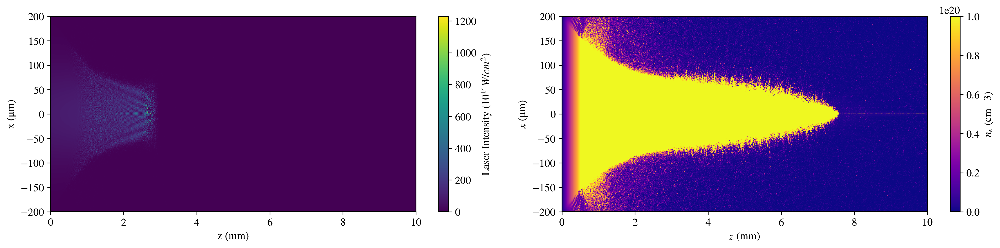

Initial pulse energy 149.78mJ
Final pulse energy 7.55mJ


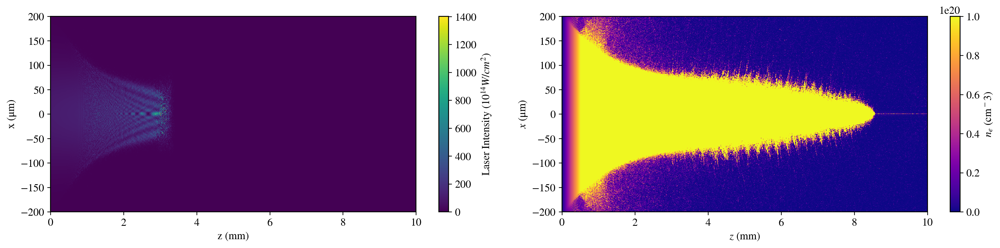

In [7]:
energy = np.array([12e-3, 25e-3, 50e-3, 75e-3, 100e-3, 125e-3, 150e-3])
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
for i in range(len(energy)):
    pulse = ionize_jet(energy[i], w0, z0, n0, atom, temp, Nx, X, Nz, Z, False)

Initial pulse energy 249.64mJ
Final pulse energy 15.18mJ


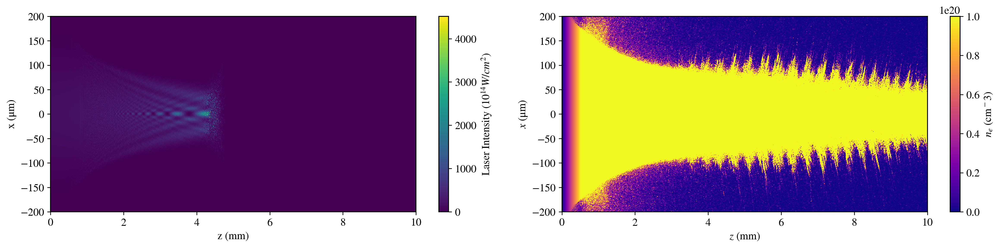

In [8]:
energy = 250e-3
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
pulse = ionize_jet(energy, w0, z0, n0, atom, temp, Nx, X, Nz, Z, False)

Initial pulse energy 249.64mJ
Final pulse energy 49.84mJ


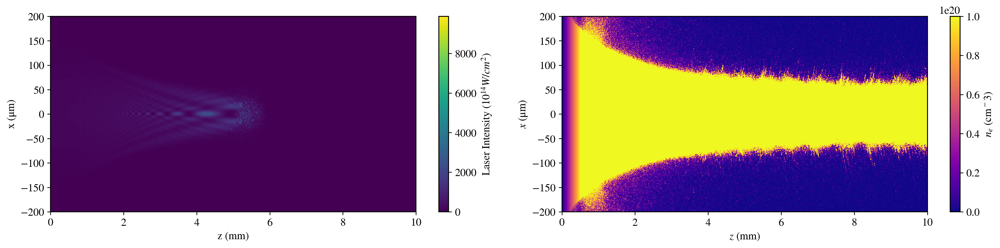

In [4]:
energy = 250e-3
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
pulse = ionize_jet(energy, w0, z0, n0, atom, temp, Nx, X, Nz, Z, False, '_Kerr', 1e-19)

Initial pulse energy 11.98mJ
Final pulse energy 3.07mJ


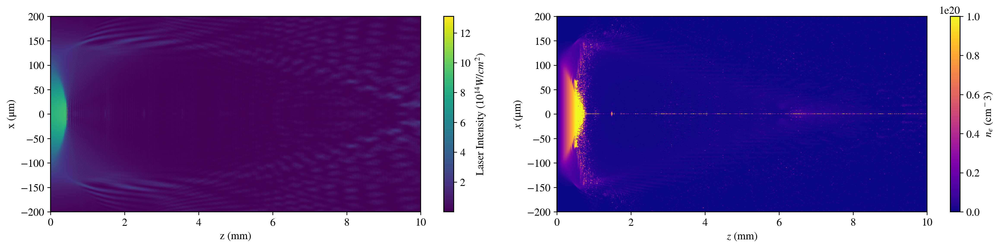

Initial pulse energy 24.96mJ
Final pulse energy 4.40mJ


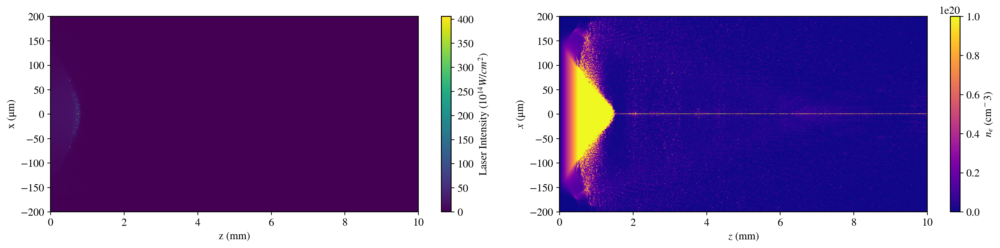

Initial pulse energy 49.93mJ
Final pulse energy 5.66mJ


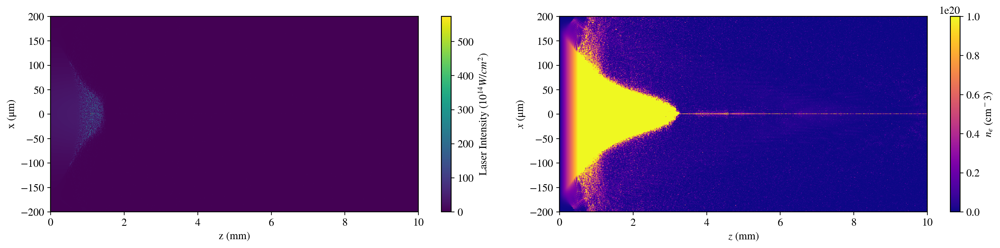

Initial pulse energy 74.89mJ
Final pulse energy 6.30mJ


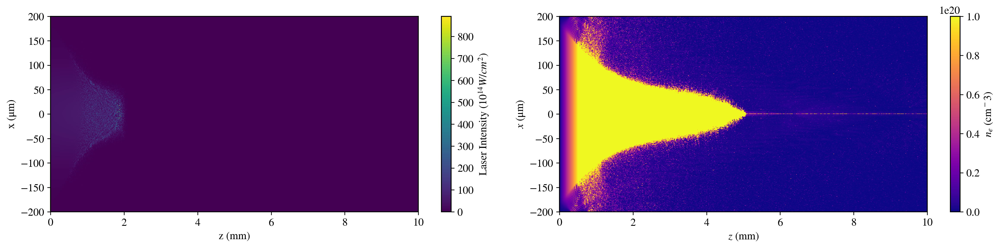

Initial pulse energy 99.86mJ
Final pulse energy 6.79mJ


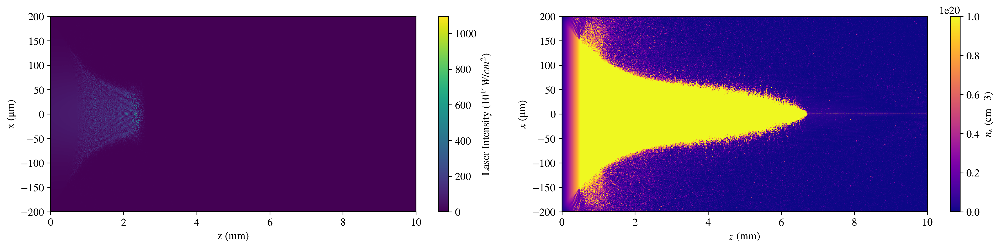

Initial pulse energy 124.82mJ
Final pulse energy 7.25mJ


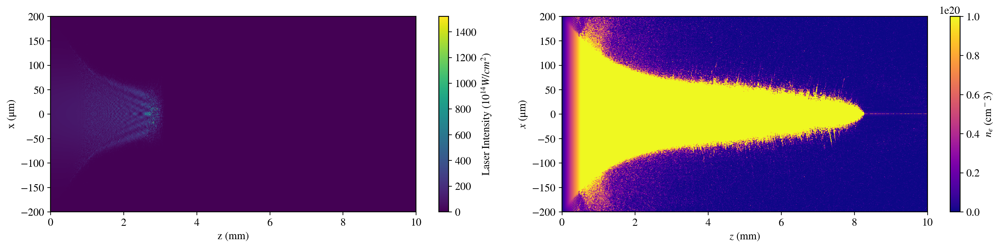

Initial pulse energy 149.78mJ
Final pulse energy 7.85mJ


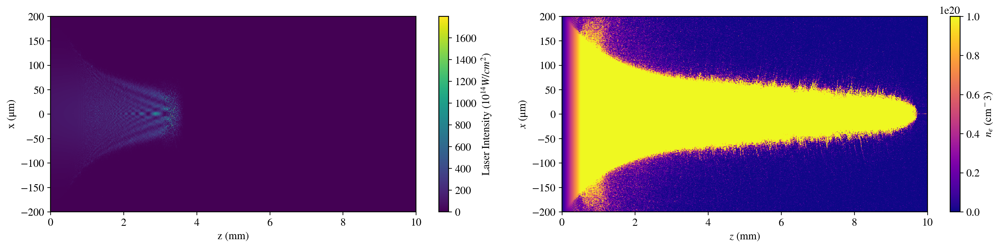

In [5]:
energy = np.array([12e-3, 25e-3, 50e-3, 75e-3, 100e-3, 125e-3, 150e-3])
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
for i in range(len(energy)):
    pulse = ionize_jet(energy[i], w0, z0, n0, atom, temp, Nx, X, Nz, Z, False, '_Kerr', 1e-19)

In [6]:
design.pulse_evolution(pulse, '1e20_150mJ_KerrEffect', [-200, 200], False)

Frame 30 completed
Frame 60 completed
Frame 90 completed
Frame 120 completed
Frame 150 completed
Frame 180 completed
Frame 210 completed
Frame 240 completed
Frame 270 completed
Frame 300 completed
Frame 330 completed
Frame 360 completed
Frame 390 completed
Frame 420 completed
Frame 450 completed
Frame 480 completed
Frame 510 completed
Frame 540 completed
Frame 570 completed
Frame 600 completed
Frame 630 completed
Frame 660 completed
Frame 690 completed
Frame 720 completed
Frame 750 completed
Frame 780 completed


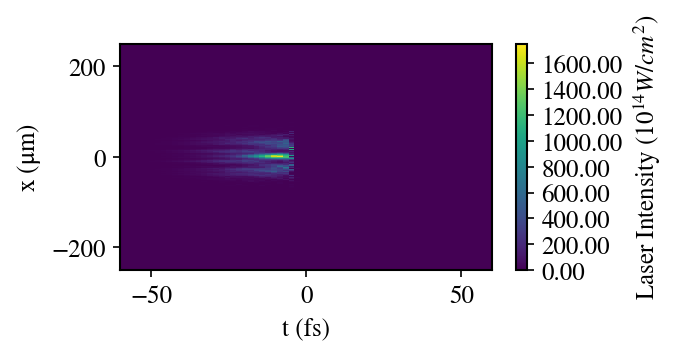

In [15]:
design.plot_pulse(pulse, 320, ylim=None, log=False)

In [19]:
# Calculate normalized vector potential
from scipy.constants import physical_constants as consts
me = consts['electron mass']
c = consts['speed of light in vacuum']
e = consts['elementary charge']
a0 = 0.855*0.8*np.sqrt(5000e-4)
print(a0)

0.483661038332


Initial pulse energy 11.98mJ
Final pulse energy 4.50mJ


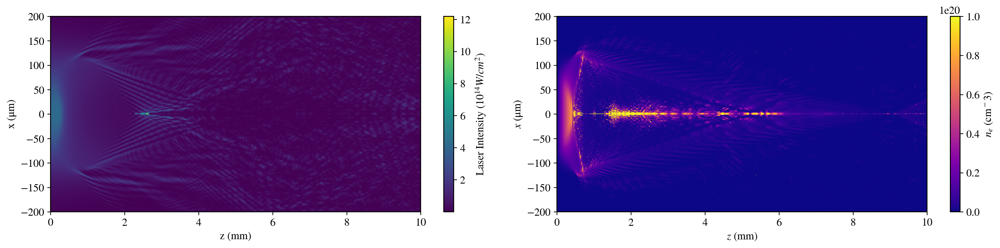

Initial pulse energy 24.96mJ
Final pulse energy 7.34mJ


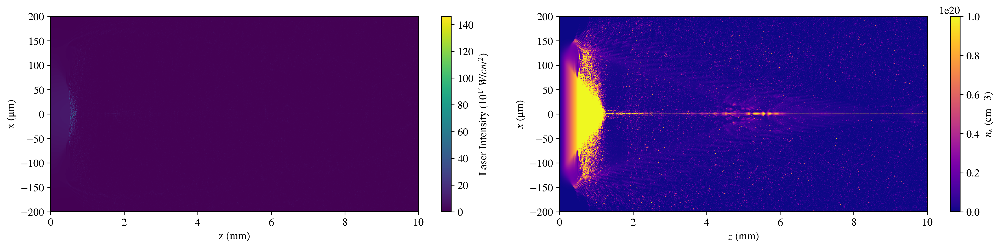

Initial pulse energy 49.93mJ
Final pulse energy 10.08mJ


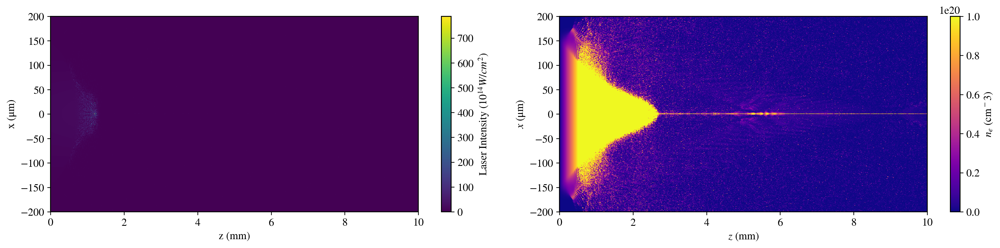

Initial pulse energy 74.89mJ
Final pulse energy 11.42mJ


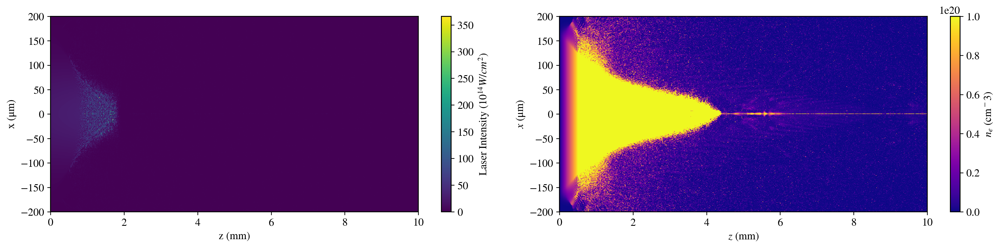

Initial pulse energy 99.86mJ
Final pulse energy 12.34mJ


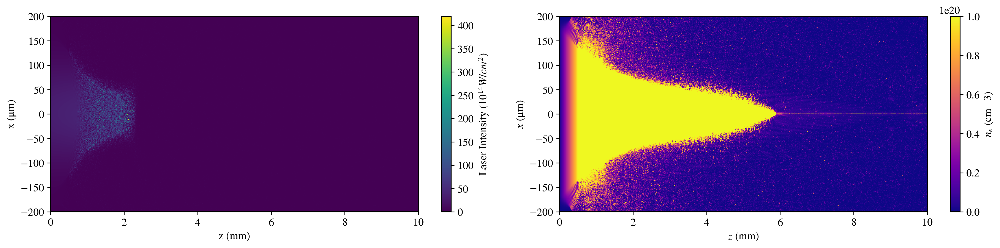

Initial pulse energy 124.82mJ
Final pulse energy 13.12mJ


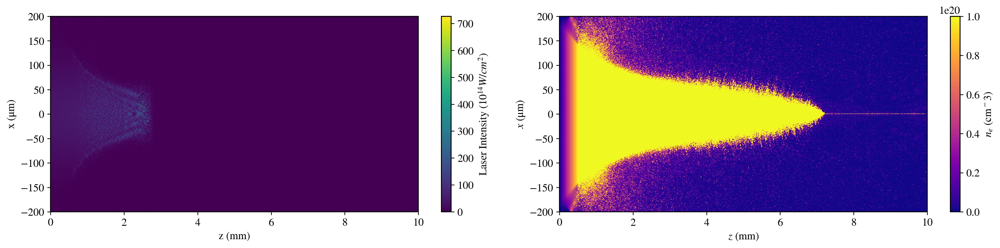

Initial pulse energy 149.78mJ
Final pulse energy 13.86mJ


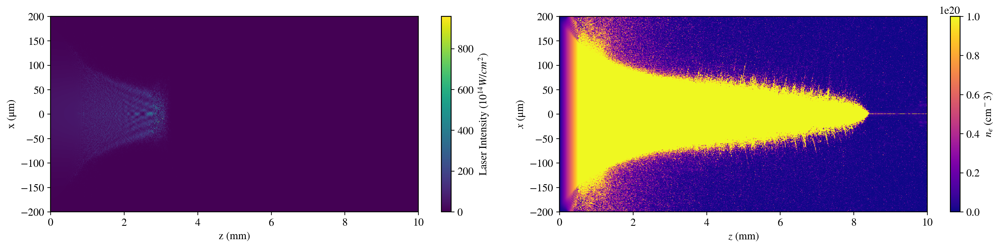

In [18]:
tau = 80.
energy = np.array([12e-3, 25e-3, 50e-3, 75e-3, 100e-3, 125e-3, 150e-3])
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
for i in range(len(energy)):
    pulse = ionize_jet(energy[i], w0, z0, n0, atom, temp, Nx, X, Nz, Z, False, '_80fs', 1e-19)
tau = 40.

Initial pulse energy 249.64mJ
Final pulse energy 33.14mJ


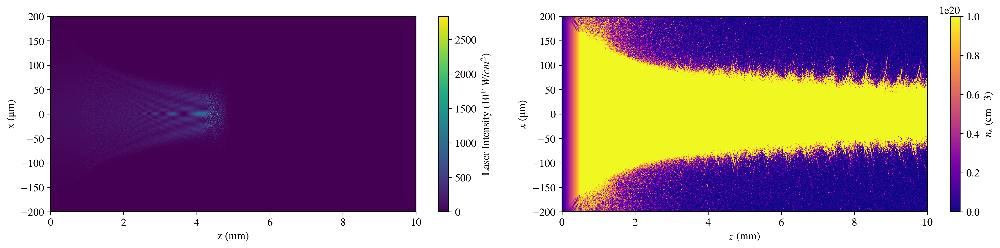

In [27]:
tau = 80.
energy = 250e-3
w0 = 15
Nx = 2**9
X = 500
Nz = 800
Z = 10e3
z0 = -8.9e3
n0 = 1e20
atom = ionization.H2
temp = 20
pulse = ionize_jet(energy, w0, z0, n0, atom, temp, Nx, X, Nz, Z, False, '_80fs', 1e-19)
tau = 40.

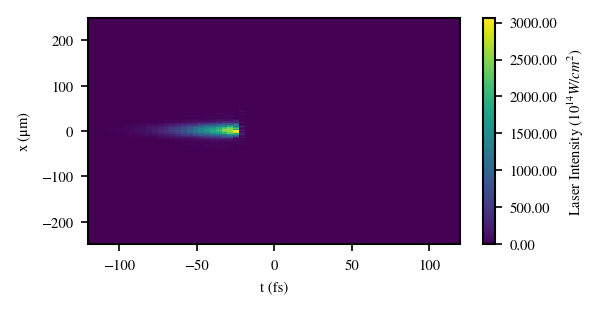

0.483661038332


In [71]:
plt.style.use('notes')
design.plot_pulse(pulse, 590, ylim=None, log=False)
a0 = 0.855*0.8*np.sqrt(5000e-4)
print(a0)